# DNA photolithography oligo Illumina seq

## Imports

In [1]:
# Standard lib packages
import os
from datetime import date
from collections import Counter, OrderedDict, namedtuple, defaultdict
from glob import glob
from shutil import rmtree
import itertools
from pprint import pprint as pp
from bisect import bisect

# Third party packages
from pycltools.pycltools import *
from IPython.core.display import display, HTML, Markdown, Image, clear_output
import pysam
import numpy as np
import HTSeq
from tqdm import tqdm
import pyfaidx
from pyfaidx import Fasta 
from scipy.ndimage.filters import gaussian_filter1d
import statsmodels as sm

# Matplotlib and Seaborn
import matplotlib as mpl
import matplotlib.pyplot as pl
import matplotlib.patches as mpatches
from matplotlib import cm
import seaborn as sns
%matplotlib inline

# Pandas
import pandas as pd
pd.options.display.max_colwidth = 200
pd.options.display.max_columns = 200
pd.options.display.max_rows = 200
pd.options.display.min_rows = 200


Bad key "text.kerning_factor" on line 4 in
/nfs/software/birney/adrien/miniconda3/envs/Python3.7/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


## Notebook info

In [3]:
jprint("Adrien Leger / EMBL EBI", bold=True, size=150)
jprint("Starting date : 2018_12_14", bold=True, italic=True, size=125)
jprint("Last modification date : {}_{}_{}".format(date.today().year, date.today().month, date.today().day), bold=True, italic=True, size=125)

# Reference

In [97]:
# Create result dir
outdir = "./references"
rmtree(outdir, ignore_errors=True)
mkdir(outdir)

ref_src = "/nfs/leia/research/enright/nanopore/experiment_design/On_Chip_RNA_Synthesis_Design/DNA_test_sequence_panel_selection.fa"
ref_dest = f"{outdir}/ref.fa"
copyFile(ref_src, ref_dest)
index = pyfaidx.Fasta(ref_dest)

# Clean reads

In [24]:
# Shared options
outdir = "cutadapt"
virtualenv = "Cutadapt_1.1.18"

# Create result dir
rmtree(outdir, ignore_errors=True)
mkdir(outdir)

sample_dict = {
    "normal":(
        "/hps/research1/birney/users/adrien/misc/datasets/photolithography_oligo_illumina_DNA/fastq/normal_S1_L001_R1_001.fastq.gz",
        "/hps/research1/birney/users/adrien/misc/datasets/photolithography_oligo_illumina_DNA/fastq/normal_S1_L001_R2_001.fastq.gz"),
    "cap_protected":(
        "/hps/research1/birney/users/adrien/misc/datasets/photolithography_oligo_illumina_DNA/fastq/cap-protected_S2_L001_R1_001.fastq.gz",
        "/hps/research1/birney/users/adrien/misc/datasets/photolithography_oligo_illumina_DNA/fastq/cap-protected_S2_L001_R2_001.fastq.gz"),
    "increased_space":(
        "/hps/research1/birney/users/adrien/misc/datasets/photolithography_oligo_illumina_DNA/fastq/increased-space_S3_L001_R1_001.fastq.gz",
        "/hps/research1/birney/users/adrien/misc/datasets/photolithography_oligo_illumina_DNA/fastq/increased-space_S3_L001_R2_001.fastq.gz")}

for id, (R1, R2) in sample_dict.items():
    jprint (f"Clean reads with cutadapt: {id}", bold=True)
    bsub_stout = f"{outdir}/{id}_stdout.txt"
    R1_out = f"{outdir}/{id}_R1_cleaned.fastq"
    R2_out = f"{outdir}/{id}_R2_cleaned.fastq"
    cmd = f"cutadapt -b AGATCGGAAGAGCACACGTCTGAACTCCAGTCAC -B AGATCGGAAGAGCGTCGTGTAGGGAAAGAGTGTAGATCTCGGTGGTCGCCGTATCATT --trim-n --minimum-length 20 -o {R1_out} -p {R2_out} {R1} {R2}"
    bsub (cmd, virtualenv=virtualenv, stdout_fp=bsub_stout, threads=2, mem=2000)
    
bjobs_lock()

for i in glob.glob("cutadapt/*stdout.txt"):
    jprint (i, bold=True)
    grep (i, ["Total read pairs processed", "Read 1 with adapter", "Read 2 with adapter", "Pairs that were too short", "Pairs written"])

Creating /nfs/leia/research/enright/nanopore/analyses/DNA_photolithography_oligo_illumina/cutadapt


bsub -M 2000 -R 'rusage[mem=2000]' -n 2 -oo cutadapt/normal_stdout.txt  "cutadapt -b AGATCGGAAGAGCACACGTCTGAACTCCAGTCAC -B AGATCGGAAGAGCGTCGTGTAGGGAAAGAGTGTAGATCTCGGTGGTCGCCGTATCATT --trim-n --minimum-length 20 -o cutadapt/normal_R1_cleaned.fastq -p cutadapt/normal_R2_cleaned.fastq /nfs/leia/research/enright/nanopore/datasets/DNA_photolithography_oligo_illumina/fastq/normal_S1_L001_R1_001.fastq.gz /nfs/leia/research/enright/nanopore/datasets/DNA_photolithography_oligo_illumina/fastq/normal_S1_L001_R2_001.fastq.gz"
Job <1527474> is submitted to default queue <standard>.


bsub -M 2000 -R 'rusage[mem=2000]' -n 2 -oo cutadapt/cap_protected_stdout.txt  "cutadapt -b AGATCGGAAGAGCACACGTCTGAACTCCAGTCAC -B AGATCGGAAGAGCGTCGTGTAGGGAAAGAGTGTAGATCTCGGTGGTCGCCGTATCATT --trim-n --minimum-length 20 -o cutadapt/cap_protected_R1_cleaned.fastq -p cutadapt/cap_protected_R2_cleaned.fastq /nfs/leia/research/enright/nanopore/datasets/DNA_photolithography_oligo_illumina/fastq/cap-protected_S2_L001_R1_001.fastq.gz /nfs/leia/research/enright/nanopore/datasets/DNA_photolithography_oligo_illumina/fastq/cap-protected_S2_L001_R2_001.fastq.gz"
Job <1527475> is submitted to default queue <standard>.


bsub -M 2000 -R 'rusage[mem=2000]' -n 2 -oo cutadapt/increased_space_stdout.txt  "cutadapt -b AGATCGGAAGAGCACACGTCTGAACTCCAGTCAC -B AGATCGGAAGAGCGTCGTGTAGGGAAAGAGTGTAGATCTCGGTGGTCGCCGTATCATT --trim-n --minimum-length 20 -o cutadapt/increased_space_R1_cleaned.fastq -p cutadapt/increased_space_R2_cleaned.fastq /nfs/leia/research/enright/nanopore/datasets/DNA_photolithography_oligo_illumina/fastq/increased-space_S3_L001_R1_001.fastq.gz /nfs/leia/research/enright/nanopore/datasets/DNA_photolithography_oligo_illumina/fastq/increased-space_S3_L001_R2_001.fastq.gz"
Job <1527476> is submitted to default queue <standard>.


No unfinished job found


All jobs done                              


Total read pairs processed:            409,545
Read 1 with adapter:                  31,987 (7.8%)
Read 2 with adapter:                  20,258 (4.9%)
Pairs that were too short:             207,920 (50.8%)
Pairs written (passing filters):       201,625 (49.2%)


Total read pairs processed:            322,883
Read 1 with adapter:                  29,615 (9.2%)
Read 2 with adapter:                  16,647 (5.2%)
Pairs that were too short:             203,310 (63.0%)
Pairs written (passing filters):       119,573 (37.0%)


Total read pairs processed:            445,119
Read 1 with adapter:                  36,199 (8.1%)
Read 2 with adapter:                  22,311 (5.0%)
Pairs that were too short:             200,568 (45.1%)
Pairs written (passing filters):       244,551 (54.9%)


# Align with Bowtie

In [ ]:
# Shared options
outdir = "bowtie2"
virtualenv = "Bowtie2_2.3.4.3"

# Create result dir
rmtree(outdir, ignore_errors=True)
mkdir(outdir)

# Index
jprint (f"Index ref genome", bold=True)
ref = "references/ref.fa"
index_fn = f"{outdir}/ref.fa"
jobid1 = bsub (cmd=f"bowtie2-build {ref} {index_fn}", virtualenv=virtualenv, threads=2, mem=2000)

for id in ["normal", "cap_protected", "increased_space"]:
    jprint (f"Align sample: {id}", bold=True)
    R1 = f"cutadapt/{id}_R1_cleaned.fastq"
    R2 = f"cutadapt/{id}_R2_cleaned.fastq"    
    bam = f"{outdir}/{id}.bam"
    cmd = f"bowtie2 --dovetail --local -D 20 -R 3 -L 12 -i S,1,0.50 -p 20 -x {index_fn} -1 {R1} -2 {R2} | samtools view -bh | samtools sort -o {bam}"
    jobid2 = bsub (cmd=cmd, virtualenv=virtualenv, threads=20, mem=2000, wait_jobid=jobid1)
    jobid3 = bsub (cmd=f"samtools index {bam}", virtualenv=virtualenv, wait_jobid=jobid2)

bjobs_lock()

# Evaluate error rate

## Count mismatch and indels

In [17]:
def count_mismatch_indels (bam_fn, fasta_fn, flag_filter=0, flag_require=0):
    
    all_dict = defaultdict (Counter)
    detailed_dict = defaultdict (Counter)
    
    # open fasta reference
    with ps.FastaFile(fasta_fn) as fasta_fp:
        
        # iterate over bam files found
        for bam_fn in glob.glob (bam_fn):
            with ps.AlignmentFile(bam_fn, "rb") as bam_fp: 

                label = bam_fn.split("/")[-1].split(".")[0]
                jprint ("Parse bam {}".format(label), bold=True)

                # Create a pileup object
                pile = bam_fp.pileup(fastafile=fasta_fp, flag_filter=flag_filter, flag_require=flag_require)
                for i in pile:
                    ref_base = fasta_fp[i.reference_name][i.pos]

                    # Get position level stats
                    for m in i.get_query_sequences(mark_matches=True, add_indels=True):
                        if m in (".", ","):
                            detailed_dict[label]["match"]+=1
                            all_dict[label]["match"]+=1
                        elif m == "*":
                            pass
                        elif m.upper() in ["A", "T", "C", "G"]:
                            detailed_dict[label][f"mismatch:{ref_base}>{m.upper()}"]+=1
                            all_dict[label]["mismatch"]+=1
                        elif m[1] == "-":
                            l = int(re.search("[[0-9]+", m).group(0))
                            detailed_dict[label][f"deletion:{l}"]+=l
                            all_dict[label]["deletion"]+=l
                        elif m[1] == "+":
                            l = int(re.search("[[0-9]+", m).group(0))
                            detailed_dict[label][f"insertion:{l}"]+=l
                            all_dict[label]["insertion"]+=l

    all_df = pd.DataFrame(all_dict)
    detailed_df = pd.DataFrame(detailed_dict)
    all_df = all_df.sort_values(by=all_df.columns[0], ascending=False)
    detailed_df = detailed_df.sort_values(by=detailed_df.columns[0], ascending=False)
    for col in all_df.columns:
        all_df[col+"%"] = all_df[col]/all_df[col].sum()*100    
    for col in detailed_df.columns:
        detailed_df[col+"%"] = detailed_df[col]/detailed_df[col].sum()*100
    return all_df, detailed_df

In [18]:
# Shared options
outdir = "bowtie2"
ref = "references/ref.fa"

jprint ("Summarize mapping results", bold=True)
df = bam_align_summary(f"{outdir}/*.bam")
display(df)
df.to_csv(f"{outdir}/alignment_rate.tsv", sep="\t", index_label="type", na_rep=0)

jprint ("Summarize mismatch types", bold=True)
all_df, detailed_df = count_mismatch_indels(f"{outdir}/*.bam", fasta_fn=ref, flag_filter=2308, flag_require=2)
display(all_df)
display(detailed_df)
all_df.to_csv(f"{outdir}/all_mismatch_table.tsv", sep="\t", index_label="type", na_rep=0)
detailed_df.to_csv(f"{outdir}/detailed_mismatch_table.tsv", sep="\t", index_label="type", na_rep=0)

,normal,increased_space,cap_protected
primary,181356,85093,261750
primary bases,11547238,5329039,17162439
primary high mapq,29834,16209,55526
unmapped,221894,154053,227352


,normal,increased_space,cap_protected,normal%,increased_space%,cap_protected%
match,4270115,1992051,6461636,92.862926,93.091106,92.945443
deletion,256457,132156,411914,5.577215,6.175820,5.925052
mismatch,44890,12079,39176,0.976231,0.564467,0.563515
insertion,26837,3608,39348,0.583629,0.168606,0.565989


,normal,increased_space,cap_protected,normal%,increased_space%,cap_protected%
match,4270115.0,1992051.0,6461636.0,92.862926,93.091106,92.945443
deletion:1,185045.0,93140.0,296404.0,4.024205,4.352552,4.263533
deletion:2,49866.0,26380.0,81050.0,1.084444,1.232771,1.165839
insertion:1,26263.0,3525.0,38801.0,0.571146,0.164728,0.558121
mismatch:G>T,14425.0,4735.0,4539.0,0.313703,0.221273,0.065290
deletion:3,13338.0,7620.0,20964.0,0.290064,0.356092,0.301550
mismatch:C>G,5916.0,766.0,3111.0,0.128656,0.035796,0.044749
deletion:4,3944.0,2644.0,6096.0,0.085771,0.123558,0.087686
mismatch:A>C,3636.0,1137.0,4044.0,0.079073,0.053133,0.058170
mismatch:C>A,3323.0,1084.0,2924.0,0.072266,0.050657,0.042059


## Probe location info

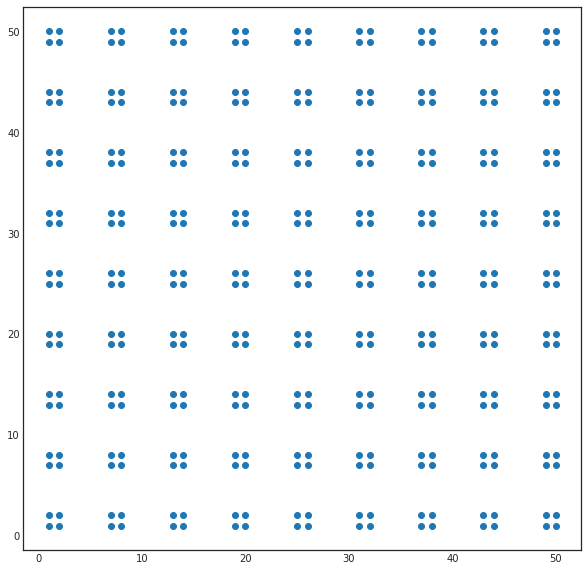

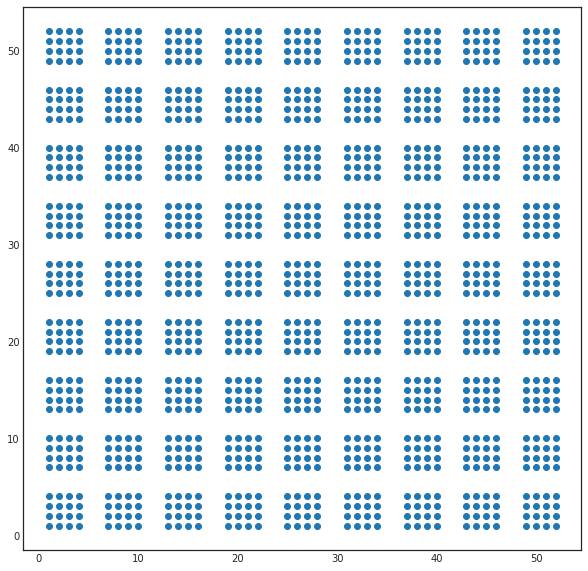

In [222]:
df = pd.read_table("./probe_info/NanoporeDNA_SZ4-designFile.ndf")
df = df [(df["X"]<54) & (df["Y"]<54) ]
df = df.sort_values(["PROBE_SEQUENCE", "X", "Y"])
with pl.style.context("seaborn-white"):
    fig, ax = pl.subplots(figsize=(10, 10))
    pl.scatter(df["X"], df["Y"])
    
df = pd.read_table("./probe_info/NanoporeDNA-designFile.ndf")
df = df [(df["X"]<54) & (df["Y"]<54) ]
df = df.sort_values(["PROBE_SEQUENCE", "X", "Y"])
with pl.style.context("seaborn-white"):
    fig, ax = pl.subplots(figsize=(10, 10))
    pl.scatter(df["X"], df["Y"])

## Write coordinate reference files

### Define functions

In [78]:
def get_coordinates (layout_fn, fasta_fn, out_fn, label, square_len=4, spacer_len=2):
    
    XMAX= 170
    YMAX= 127
    r_type_l = [
        {"area":4, "xmin":0, "xmax":XMAX//10, "ymin":0 , "ymax":YMAX//10},
        {"area":4, "xmin":0, "xmax":XMAX//10, "ymin":YMAX-YMAX//10 , "ymax":YMAX},
        {"area":4, "xmin":XMAX-XMAX//10, "xmax":XMAX, "ymin":0 , "ymax":YMAX//10},
        {"area":4, "xmin":XMAX-XMAX//10, "xmax":XMAX, "ymin":YMAX-YMAX//10 , "ymax":YMAX},
        {"area":1, "xmin":XMAX//5, "xmax":XMAX-XMAX//5, "ymin":YMAX//5 , "ymax":YMAX-YMAX//5},
        {"area":2, "xmin":XMAX//10, "xmax":XMAX-XMAX//10, "ymin":YMAX//10 , "ymax":YMAX-YMAX//10},
        {"area":3, "xmin":0, "xmax":XMAX, "ymin":0 , "ymax":YMAX}]

    # Calculate number of spots and offset 
    n_spots = square_len*square_len
    offset = square_len + spacer_len   

    # Import file
    print("Parse Layout file")
    df = pd.read_table(layout_fn)
    df.sort_values(["PROBE_SEQUENCE", "X", "Y"], inplace=True)

    # Collapse value per unique spot
    l = []
    for i in tqdm (range(0, len(df), n_spots)):
        sdf = df.iloc[i:i+n_spots]
        assert len(sdf["SEQ_ID"].unique()) == 1
        s = sdf.iloc[0]
        l.append ({"seq":s["SEQ_ID"], "X":s["X"], "Y":s["Y"]})
    
    # Cast to dataaframe
    layout_df = pd.DataFrame(l)

    # Sort by coordinates and normalise to minimal integer
    layout_df.sort_values(["X", "Y"], inplace=True)
    layout_df["X"] = (layout_df["X"]-1)//offset
    layout_df["Y"] = (layout_df["Y"]-1)//offset
    
    # Count number of occurence per sequence
    counts = layout_df["seq"].value_counts()
    l = []
    for seq in layout_df["seq"]:
        l.append(counts[seq])
    layout_df["count"] = l    
    layout_df.drop_duplicates(inplace=True, ignore_index=True)
    
    # Region type color
    l = []
    for line in layout_df.itertuples():
        for r_type in r_type_l:
            if (r_type["xmin"] <= line.X <= r_type["xmax"]) and (r_type["ymin"] <= line.Y <= r_type["ymax"]):
                l.append(r_type["area"])
                break
    layout_df["area"] = l
    
    print("Parse Fasta file")
    l = []
    for seq in Fasta(fasta_fn):
        l.append({"seq":str(seq), "name":seq.name})
    fasta_df = pd.DataFrame(l)
    fasta_df.sort_values(by="seq", inplace=True)
    
    # Merge coord and fasta df
    print("Merge dataframes")
    merged_df = pd.merge (left=fasta_df, right=layout_df, how='inner', on="seq")
    
    # Write coord file
    print("Write coord to file")
    #merged_df.sort_values(["X", "Y"], inplace=True)
    merged_df.to_csv(out_fn, sep="\t", index=False)
    
    with pl.style.context("seaborn-white"):
        fig, ax = pl.subplots(figsize=(XMAX//10, YMAX//10))
        ax.scatter(merged_df["X"], merged_df["Y"], s=10, c=merged_df["area"], cmap="Set1")
        ax.set_title (f"{label} / Coordinate map and flowcell areas")
        ax.set_xlim(0,XMAX)
        ax.set_ylim(0,YMAX)
        ax.set_xlabel ("X coordinates")
        ax.set_ylabel ("Y coordinates")
        for r_type in r_type_l:
            ymid = r_type["ymin"]+(r_type["ymax"]-r_type["ymin"])/2
            ax.text(x=r_type["xmin"]+5, y=ymid, s=r_type["area"], size=30, fontweight="bold", ha="left", va="center")

    with pl.style.context("seaborn-white"):
        fig, ax = pl.subplots(figsize=(XMAX//10, YMAX//10))
        ax.scatter(merged_df["X"], merged_df["Y"], s=10, c=merged_df["count"], cmap="copper_r")
        ax.set_title (f"{label} / Coordinate map and duplicated sequences layout")
        ax.set_xlim(0,XMAX)
        ax.set_ylim(0,YMAX)
        ax.set_xlabel ("X coordinates")
        ax.set_ylabel ("Y coordinates")
        
    return merged_df

### Normal layout

Parse Layout file


100%|██████████| 21888/21888 [00:12<00:00, 1789.70it/s]


Parse Fasta file
Merge dataframes
Write coord to file


,seq,name,X,Y,count,area
0,CCCCCCAAAAACAACTACAGAGGCTTCAATCGACGCAACGGCCCTGCTCATGATCTAAAAAAAAAAA,ref_380834,100,52,1,1
1,CCCCCCAAAAACACCATATGGCTTCAGCTATACATCGGAGTGACTCTAAACGACACAAAAAAAAAAA,ref_890642,22,113,1,2
2,CCCCCCAAAAACCCCAGCCCGAGCGCAGTAGTTTTACCCAGCTGCATTGTCTGAGGAAAAAAAAAAA,ref_801150,50,64,1,1
3,CCCCCCAAAAACCGCGTAGTCGCCGGCAACAGACAGACCGTATCGTGGATACCCGCAAAAAAAAAAA,ref_613623,131,124,1,3
4,CCCCCCAAAAACCGGCAAAACACTTAGTTGTGGAGTACTGTCGACGACCGTGATTCAAAAAAAAAAA,ref_635283,15,55,2,3


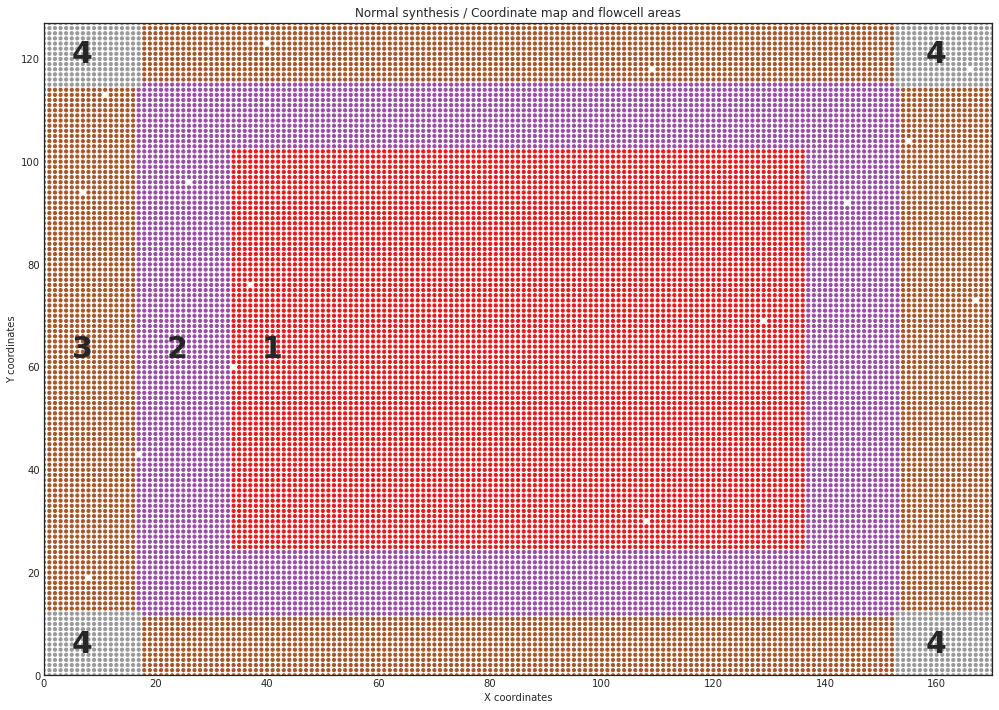

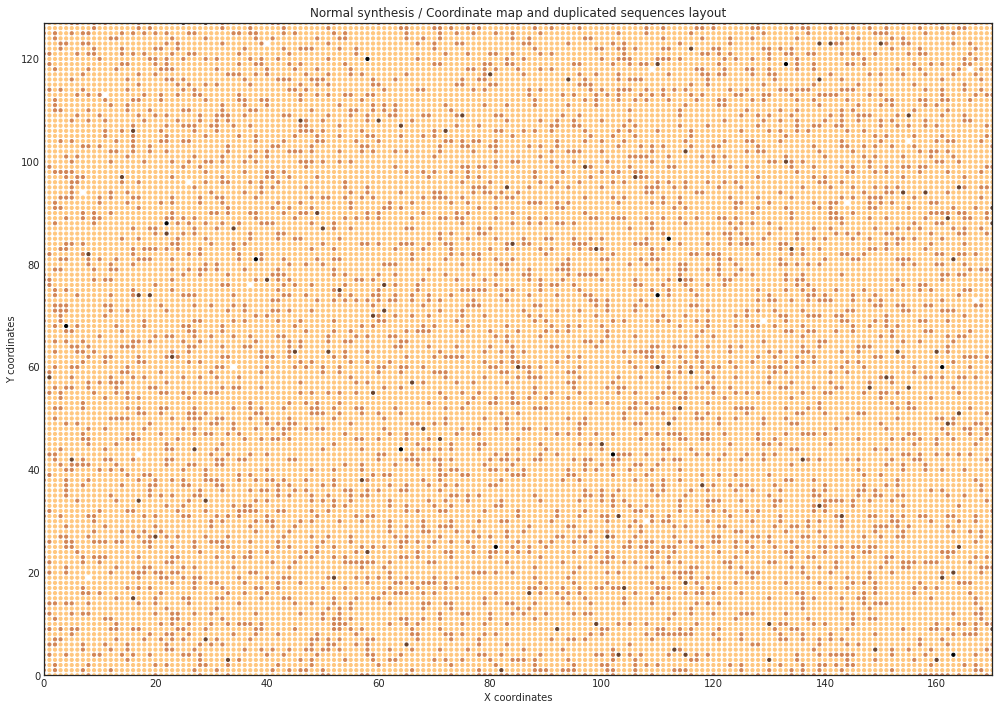

In [81]:
df = get_coordinates (
    layout_fn="./probe_info/NanoporeDNA-designFile.ndf",
    fasta_fn="./references/ref.fa",
    out_fn="./probe_info/normal_coord.tsv",
    label = "Normal synthesis",
    square_len=4, spacer_len=2)

display(df.head())

### Increased space layout

Parse Layout file


100%|██████████| 21888/21888 [00:12<00:00, 1795.03it/s]


Parse Fasta file
Merge dataframes
Write coord to file


,seq,name,X,Y,count,area
0,CCCCCCAAAAACAACTACAGAGGCTTCAATCGACGCAACGGCCCTGCTCATGATCTAAAAAAAAAAA,ref_380834,100,52,1,1
1,CCCCCCAAAAACACCATATGGCTTCAGCTATACATCGGAGTGACTCTAAACGACACAAAAAAAAAAA,ref_890642,22,113,1,2
2,CCCCCCAAAAACCCCAGCCCGAGCGCAGTAGTTTTACCCAGCTGCATTGTCTGAGGAAAAAAAAAAA,ref_801150,50,64,1,1
3,CCCCCCAAAAACCGCGTAGTCGCCGGCAACAGACAGACCGTATCGTGGATACCCGCAAAAAAAAAAA,ref_613623,131,124,1,3
4,CCCCCCAAAAACCGGCAAAACACTTAGTTGTGGAGTACTGTCGACGACCGTGATTCAAAAAAAAAAA,ref_635283,15,55,2,3


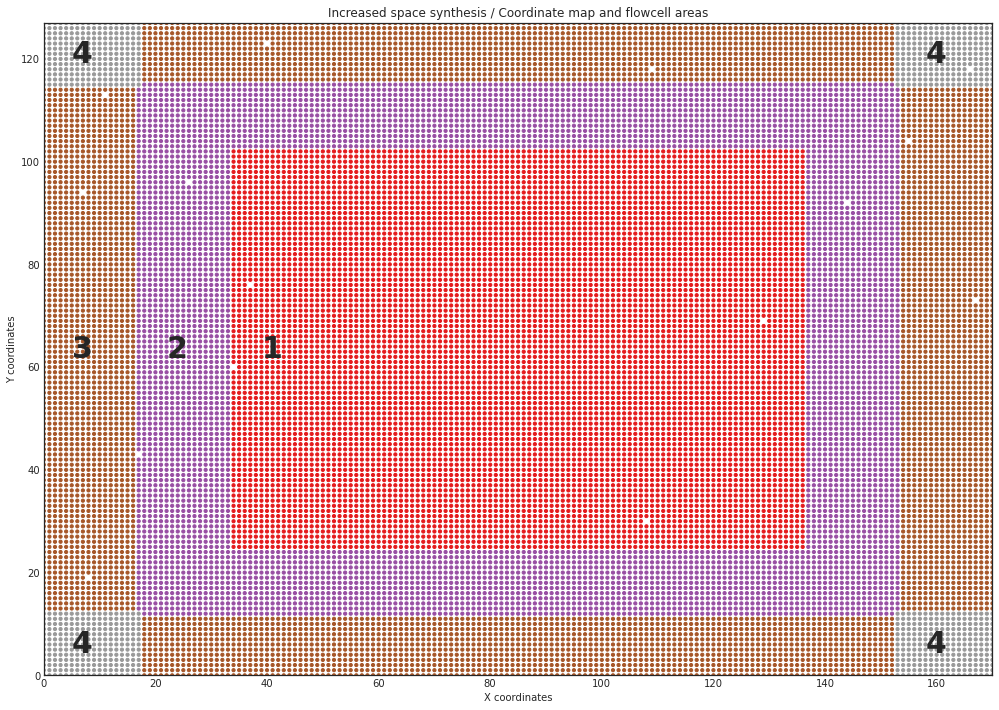

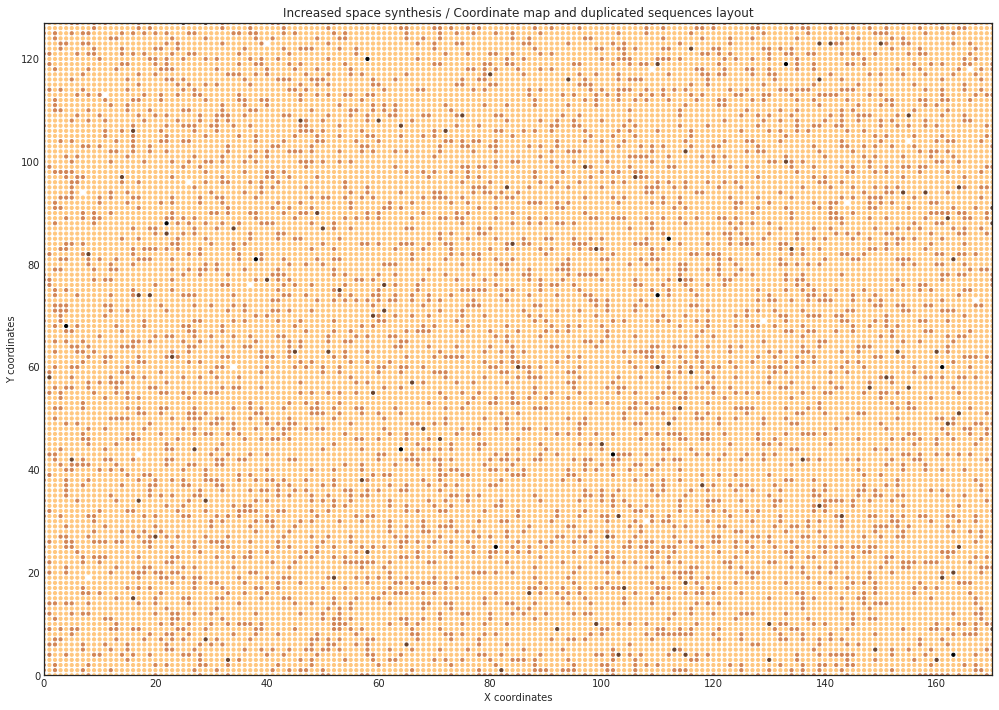

In [82]:
df = get_coordinates (
    layout_fn="./probe_info/NanoporeDNA_SZ4-designFile.ndf",
    fasta_fn="./references/ref.fa",
    out_fn="./probe_info/increased_space_coord.tsv",
    label = "Increased space synthesis",
    square_len=2, spacer_len=4)

display(df.head())

## Parse bam errors per reference 

### Define functions

In [42]:
def probe_layout (fasta_fn, coord_fn, bam_fn):
    
    stdout_print("Get error rate per reference")
    ref_dict = defaultdict(Counter)
    # open fasta reference
    with ps.FastaFile(fasta_fn) as fasta_fp, ps.AlignmentFile(bam_fn, "rb") as bam_fp: 
        # Create a pileup object
        pile = bam_fp.pileup(fastafile=fasta_fp, flag_filter=2308, flag_require=2)
        for i in tqdm(pile):
            ref_base = fasta_fp[i.reference_name][i.pos]

            # Get position level stats
            for m in i.get_query_sequences(mark_matches=True, add_indels=True):
                if m == "*":
                    pass
                elif m in (".", ","):
                    ref_dict[i.reference_name]["total"]+=1
                    ref_dict[i.reference_name]["match"]+=1
                elif m.upper() in ["A", "T", "C", "G"]:
                    ref_dict[i.reference_name]["total"]+=1
                    ref_dict[i.reference_name]["mismatch"]+=1
                elif m[1] == "-":
                    l = int(re.search("[[0-9]+", m).group(0))
                    ref_dict[i.reference_name]["total"]+= l
                    ref_dict[i.reference_name]["deletion"]+=1
                elif m[1] == "+":
                    l = int(re.search("[[0-9]+", m).group(0))
                    ref_dict[i.reference_name]["total"]+=l
                    ref_dict[i.reference_name]["insertion"]+=l
    
    error_df = pd.DataFrame.from_dict(ref_dict, orient="index")
    for field in ("match", "mismatch", "deletion", "insertion"):
        error_df[f"%{field}"] = error_df[field]/error_df["total"]*100
    error_df["Norm_expr"] = np.log2(error_df["total"]/error_df["total"].sum()*1e6)
    
    # Merge coord and fasta df
    print("Annotate with coordinates")
    coord_df = pd.read_table (coord_fn, index_col=1)
    coord_error_df = pd.merge (left=error_df, right=coord_df, how='outer', left_index=True, right_index=True)
    coord_error_df.index.name = "ref_id"

    return coord_error_df

def area_stats (df):
    d=OrderedDict()
    super_total = df["total"].sum()
    for area, area_df in df.groupby("area"):
        label = f"Area {area}"
        d[label]=OrderedDict()
        missing = len(area_df[area_df["match"].isna()])
        match = area_df["match"].sum()
        deletion = area_df["deletion"].sum()
        insertion = area_df["insertion"].sum()
        mismatch = area_df["mismatch"].sum()
        total = area_df["total"].sum()
        
        d[label]["% missing cluster"] = round(missing/len(area_df)*100, 3)
        d[label]["% match bases"] = round(match/total*100,3)
        d[label]["% deletion bases"] = round(deletion/total*100,3)
        d[label]["% insertion bases"] = round(insertion/total*100,3)
        d[label]["% mismatch bases"] = round(mismatch/total*100,3)
        d[label]["% mismatch bases"] = round(mismatch/total*100,3)
        d[label]["Normalised expression"] = round(total/len(area_df)/super_total*1e6, 3)
    return pd.DataFrame(d)

def plot_error_df (df, field="%match", cmap="gist_heat", title="", figscale=0.1, dot_size=20, bins=50, min_val=2, max_val=20):
    
    with pl.style.context("seaborn-white"):
        XMAX=df["X"].max()
        YMAX=df["Y"].max()
        
        fig = pl.figure() 
        fig.set_figheight(YMAX*figscale)
        fig.set_figwidth((XMAX+XMAX/10)*figscale)
        
        ax1 = pl.subplot2grid(shape=(3, 10), loc=(0, 0), colspan=9, rowspan=3)
        ax2 = pl.subplot2grid(shape=(3, 10), loc=(1, 9), colspan=1, rowspan=1)
        
        # Multiple
        sdf = df[df["count"]>1]
        ax1.scatter(sdf["X"], sdf["Y"], s=dot_size, c="grey", alpha=0.25, label="Duplicate")
        
        # No data
        sdf = df[df["match"].isnull()]
        ax1.scatter(sdf["X"], sdf["Y"], s=dot_size, c="dodgerblue", alpha=0.5, label="No data")
        
        # Unique
        sdf = df[(df["count"]==1) & (df["match"].notnull())]
        # Make color scale
        colors = []
        pal = sns.color_palette(cmap, bins+1)
        val_range = list(np.linspace(min_val,max_val,bins))
        for i in sdf[field]:
            col = pal[bisect.bisect_left(val_range, i)]
            colors.append(col)
        ax1.scatter(sdf["X"], sdf["Y"], s=dot_size, c=colors, label="")
        
        # Add colorbar
        cb = mpl.colorbar.ColorbarBase(ax=ax2, cmap=mpl.cm.get_cmap(cmap), norm=mpl.colors.Normalize(vmin=min_val, vmax=max_val), orientation='vertical', ticklocation="left")
        cb.set_label(field)

        # Tweak   
        ax1.set_title(title, fontsize=18)
        ax1.set_xlabel ("X coordinates")
        ax1.set_ylabel ("Y coordinates")
        ax1.set_xlim(-2,sdf["X"].max()+2)
        ax1.set_ylim(-2,sdf["Y"].max()+2)
        ax1.legend(bbox_to_anchor=(1, 1), loc=2, facecolor="white", frameon=False)
        
        tick_step = 5
        ax1.set_xticks(range(1,XMAX,tick_step))
        ax1.set_yticks(range(1,YMAX,tick_step))
        ax1.set_xticklabels([(i+2)*6 for i in range(1,XMAX,tick_step)])
        ax1.set_yticklabels([(i+2)*6 for i in range(1,YMAX,tick_step)])
        ax1.tick_params(axis='x', rotation=90)
        
        fig.tight_layout()
        return fig

### Prepare data

In [5]:
norm_df = probe_layout (fasta_fn="./references/ref.fa", coord_fn="./probe_info/normal_coord.tsv", bam_fn="./bowtie2/normal.bam")
norm_df.to_csv("./probe_info/normal_coord_error_rate.tsv", sep="\t")

cap_df = probe_layout (fasta_fn="./references/ref.fa", coord_fn="./probe_info/normal_coord.tsv", bam_fn="./bowtie2/cap_protected.bam")
cap_df.to_csv("./probe_info/cap_protected_coord_error_rate.tsv", sep="\t")

space_df = probe_layout (fasta_fn="./references/ref.fa", coord_fn="./probe_info/increased_space_coord.tsv", bam_fn="./bowtie2/increased_space.bam")
space_df.to_csv("./probe_info/increased_space_coord_error_rate.tsv", sep="\t")

print("Normal Synthesis")
display(area_stats(df=norm_df))
print("Cap protected Synthesis")
display(area_stats(df=cap_df))
print("Increased space Synthesis")
display(area_stats(df=space_df))

Get error rate per reference

0it [00:00, ?it/s]/home/aleg/miniconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: Possible nested set at position 1
1238668it [00:32, 37612.56it/s]


Annotate with coordinates
Get error rate per reference

1284211it [00:39, 32182.64it/s]


Annotate with coordinates
Get error rate per reference

1003995it [00:22, 43656.76it/s]


Annotate with coordinates
Normal Synthesis


,Area 1,Area 2,Area 3,Area 4
% missing cluster,1.208,1.772,4.999,14.225
% match bases,93.092,92.796,92.659,92.200
% deletion bases,4.519,4.753,4.885,4.952
% insertion bases,0.612,0.566,0.541,0.778
% mismatch bases,0.972,0.984,0.968,1.091
Normalised expression,51.351,47.600,39.559,29.003


Cap protected Synthesis


,Area 1,Area 2,Area 3,Area 4
% missing cluster,0.498,0.983,1.806,10.588
% match bases,93.187,92.893,92.680,92.367
% deletion bases,4.809,5.011,5.215,5.329
% insertion bases,0.579,0.569,0.532,0.623
% mismatch bases,0.560,0.567,0.555,0.641
Normalised expression,52.150,46.503,40.000,26.256


Increased space Synthesis


,Area 1,Area 2,Area 3,Area 4
% missing cluster,8.929,14.741,23.071,40.107
% match bases,93.312,92.985,92.833,92.556
% deletion bases,4.994,5.204,5.296,5.499
% insertion bases,0.167,0.162,0.186,0.225
% mismatch bases,0.552,0.579,0.564,0.604
Normalised expression,56.372,45.503,36.271,23.366


###  Define common robust boundaries for all fields

In [13]:
d = defaultdict(list)
fields = ["Norm_expr", "%match", "%mismatch", "%insertion", "%deletion"]

for df in [norm_df, cap_df, space_df]:
    for f in fields:
        d[f].append(df[f].values)

lim_d = OrderedDict()
for f in fields:
    all_val = np.concatenate(d[f])
    q = np.nanquantile(all_val, [0.01, 0.99])
    lim_d[f]=OrderedDict()
    lim_d[f]["min"] = q[0]
    lim_d[f]["max"] = q[1]
    
display(pd.DataFrame(lim_d))

,Norm_expr,%match,%mismatch,%insertion,%deletion
min,2.983916,86.915888,0.176991,0.158983,1.638899
max,7.524485,98.412698,3.703704,3.302425,9.433962


### Plot info on layout

Creating /home/aleg/Analyses/DNA_photolithography_oligo_illumina/flowcell_layout_data


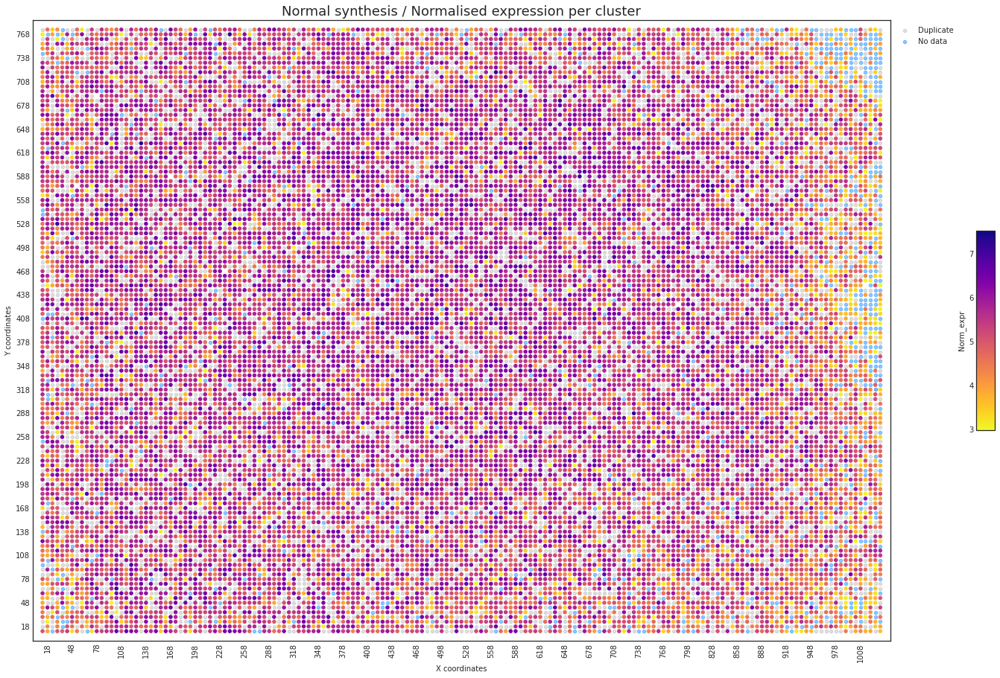

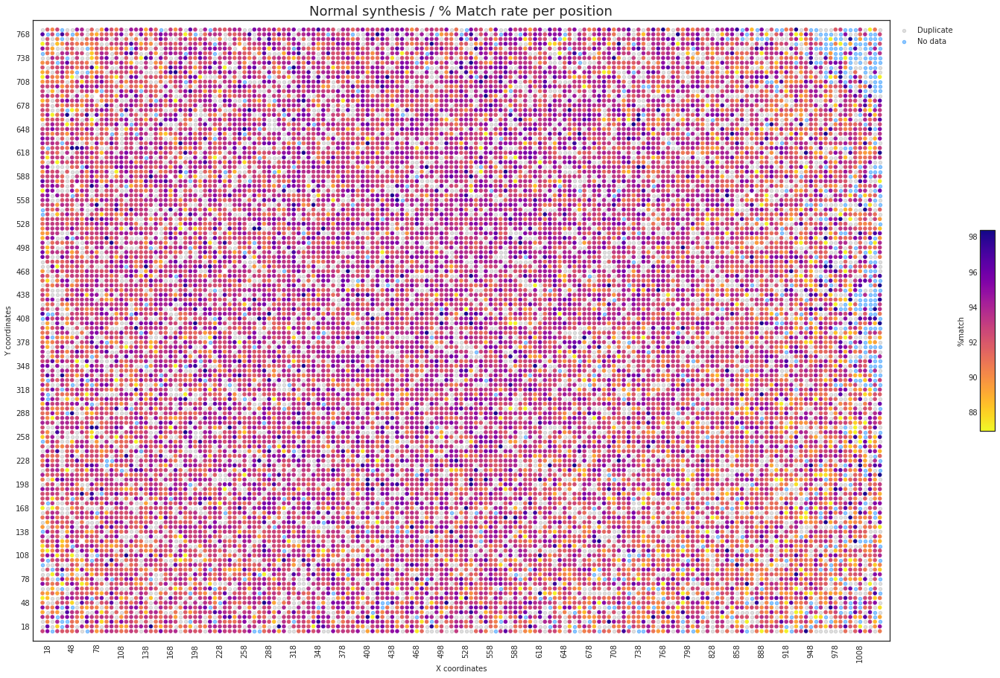

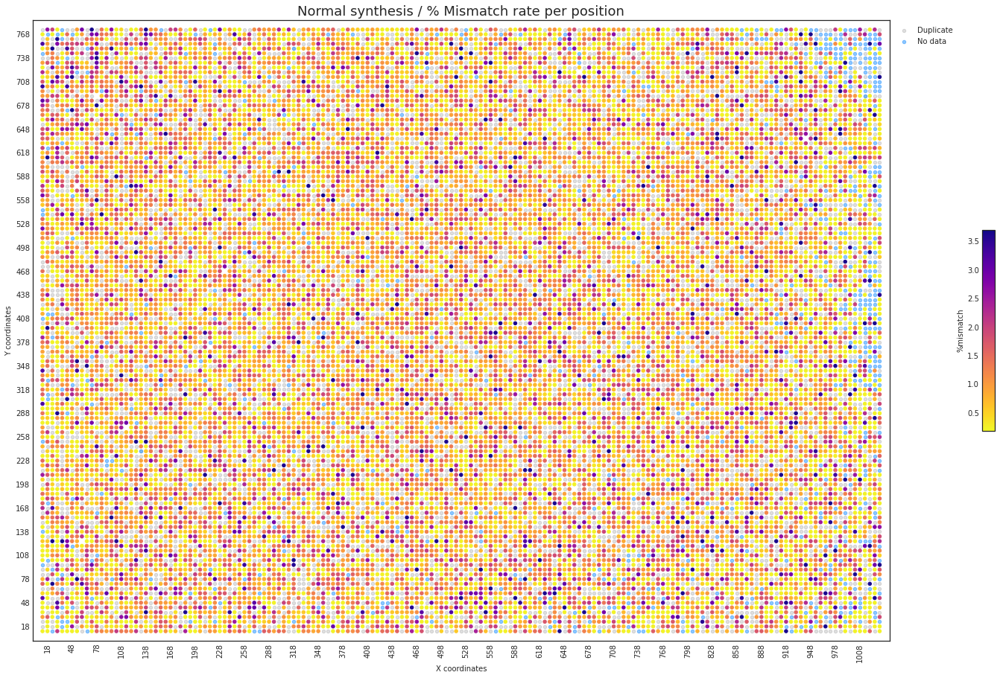

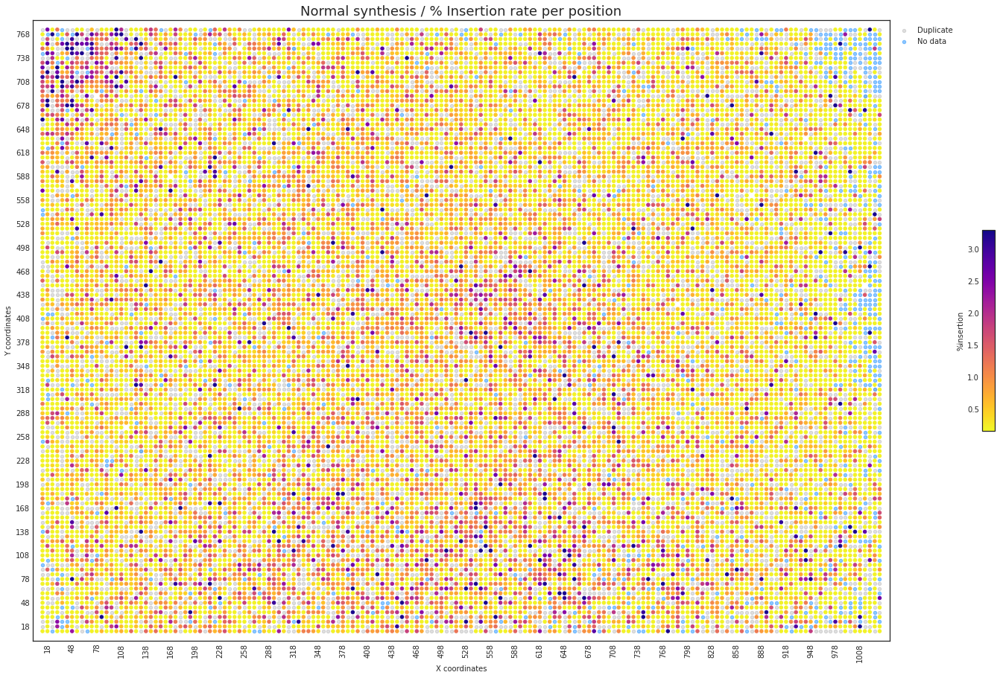

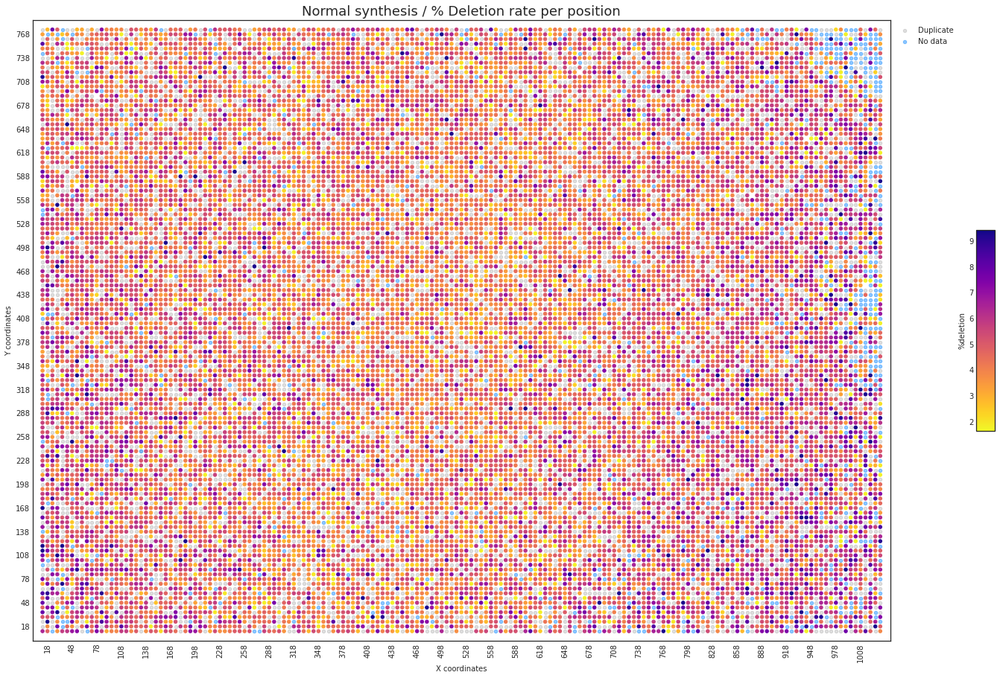

...

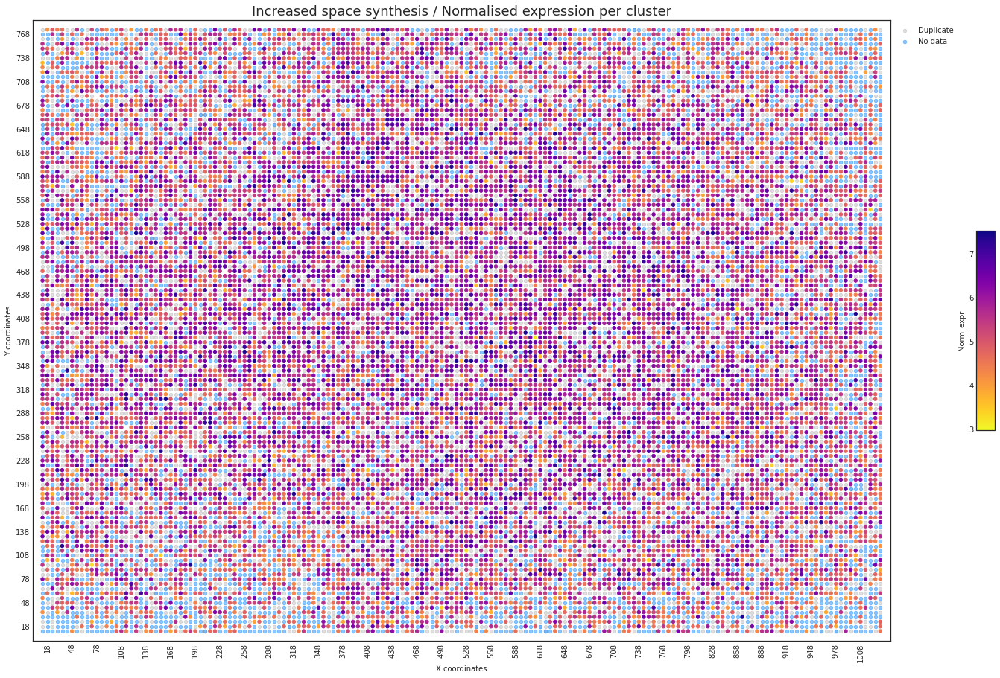

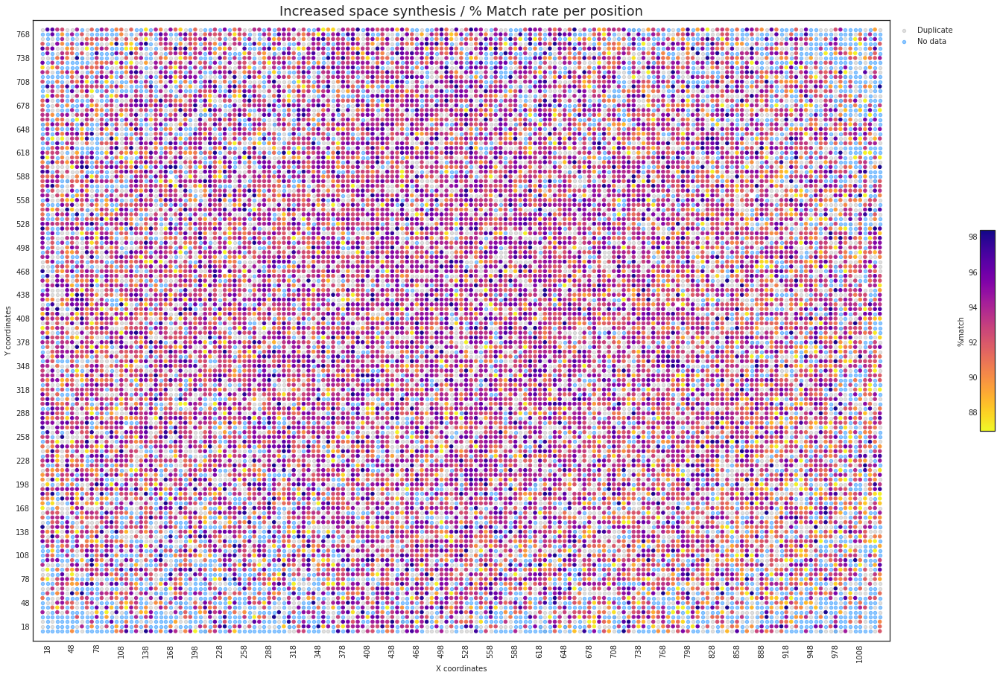

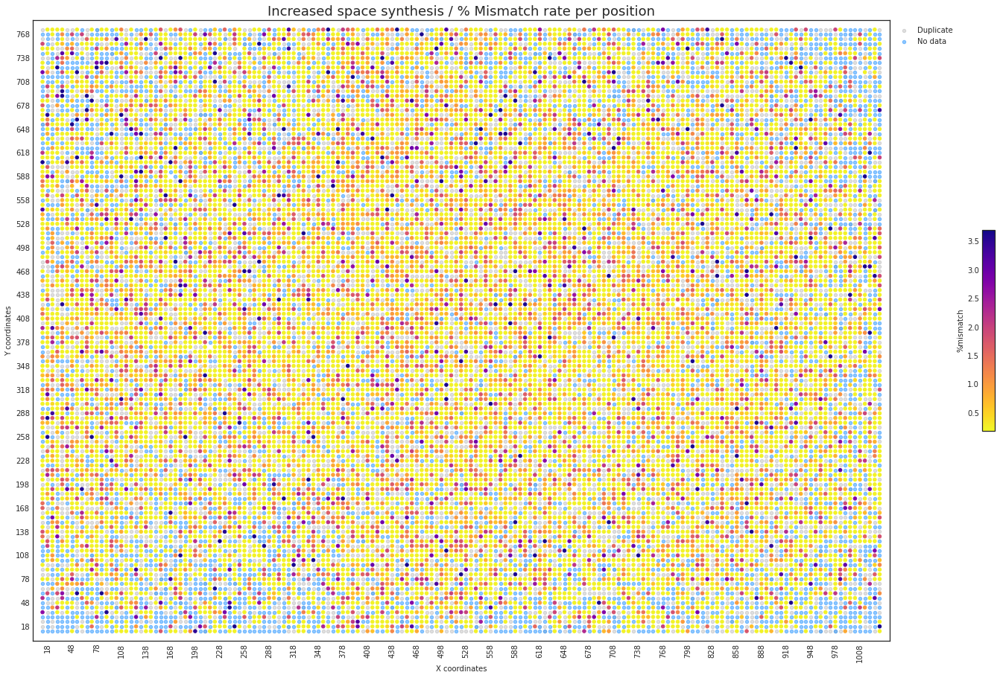

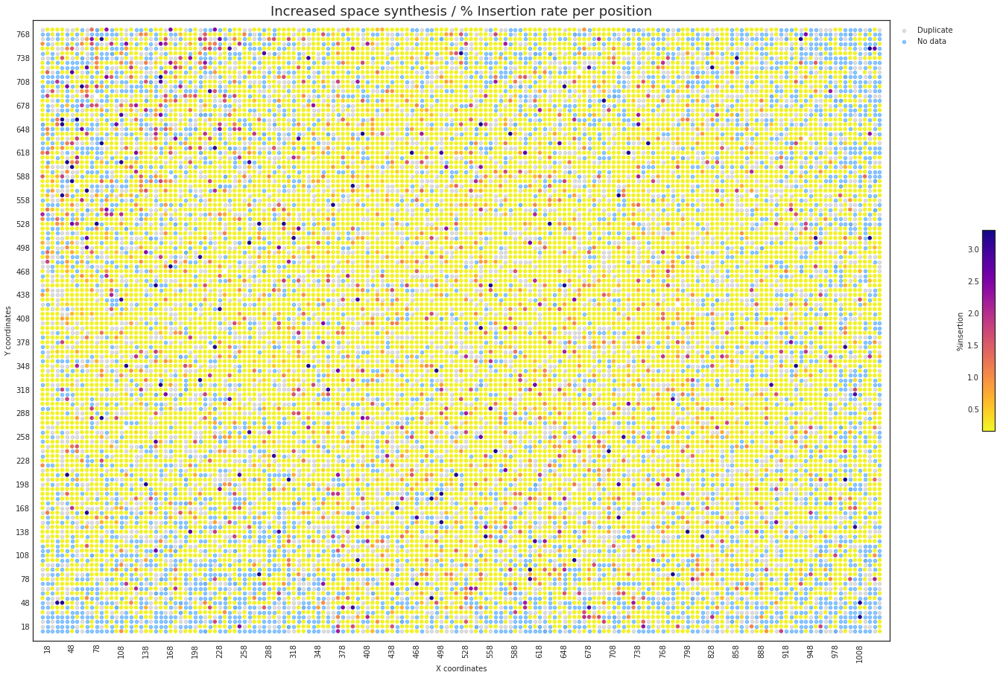

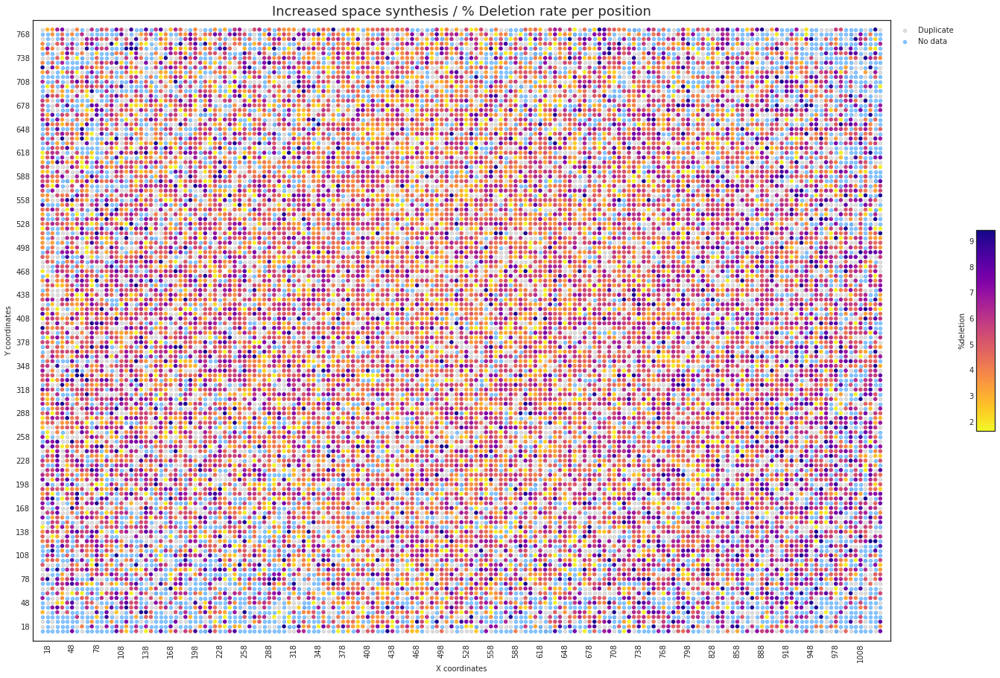

In [91]:
outdir = "flowcell_layout_data"
shutil.rmtree(outdir,ignore_errors=True)
mkdir(outdir)

for label, df in zip(["Normal synthesis", "Cap protected synthesis", "Increased space synthesis"], [norm_df, cap_df, space_df]):
#for label, df in zip(["Normal synthesis"], [norm_df]):
    for field, title in [
        ["Norm_expr", "Normalised expression per cluster"],
        ["%match", "% Match rate per position"],
        ["%mismatch", "% Mismatch rate per position"],
        ["%insertion", "% Insertion rate per position"],
        ["%deletion", "% Deletion rate per position"]]:
        
        min_val = lim_d[field]["min"]
        max_val = lim_d[field]["max"]
        fig = plot_error_df (df=df, field=field, cmap="plasma_r", title=f"{label} / {title}", figscale=0.1, dot_size=20, min_val=min_val , max_val=max_val)
        fig.savefig(f"{outdir}/{label}_{field}.svg")
        fig.savefig(f"{outdir}/{label}_{field}.png")

## Reference position wise error analysis 

### Define functions

In [199]:
def get_pos_error (
    fasta_fn, coord_fn, bam_fn, max_base=None, start=0, end=66):

    # Read coord file
    coord_df = pd.read_table (coord_fn, index_col=1)
    area_d = coord_df["area"].to_dict()
        
    # Empty dict to collect position error data
    err_d = OrderedDict()
    for area in coord_df["area"].unique():
        err_d[area] = OrderedDict()
        for field in ["total", "match", "mismatch", "deletion", "insertion"]:
            err_d[area][field] = OrderedDict()
            for pos in range (start, end+1):
                err_d[area][field][pos] = 0
                
    with ps.FastaFile(fasta_fn) as fasta_fp:
        # iterate over bam files found
        with ps.AlignmentFile(bam_fn, "rb") as bam_fp: 
            # Create a pileup object
            pile = bam_fp.pileup(fastafile=fasta_fp, flag_filter=2308, flag_require=2)

            for i in tqdm(itertools.islice(pile, max_base)):
                pos = i.pos
                if pos < start or pos > end:
                    continue
                    
                else:
                    area = area_d[i.reference_name]

                    # Get position level stats
                    for m in i.get_query_sequences(mark_matches=True, add_indels=True):
                        if m == "*":
                            continue
                        if m in (".", ","):
                            err_d[area]["total"][pos]+=1
                            err_d[area]["match"][pos]+=1

                        elif m.upper() in ["A", "T", "C", "G"]:
                            err_d[area]["total"][pos]+=1
                            err_d[area]["mismatch"][pos]+=1

                        elif m[1] == "-":
                            l = int(re.search("[[0-9]+", m).group(0))
                            for pos_offset in range(l):
                                sub_pos = pos+pos_offset
                                err_d[area]["total"][sub_pos]+=1
                                err_d[area]["deletion"][sub_pos]+=1

                        elif m[1] == "+":
                            l = int(re.search("[[0-9]+", m).group(0))
                            err_d[area]["total"][pos]+=l
                            err_d[area]["insertion"][pos]+=l
                
    
    res_d = OrderedDict()
    for area, area_d in err_d.items():
        res_d[area] = OrderedDict()
        
        # Percent of error fields
        for field in ["match", "mismatch", "deletion", "insertion"]:
            res_d[area][field] = OrderedDict()
            for (pos_total, total), (pos_val, val) in zip(area_d["total"].items(), area_d[field].items()):
                if total:
                    res_d[area][field][pos_total] = val/total
                else:
                    res_d[area][field][pos_total]=0
        
        # Normalised coverage
        field_lab = "coverage"
        res_d[area][field_lab] = OrderedDict()
        total_sum = sum(list(area_d["total"].values()))
        for pos, val in area_d["total"].items():
            res_d[area][field_lab][pos] = val/total_sum
        
    return res_d
            
def plot_res_area (res_d, title=""):
    with pl.style.context("ggplot"):
        err_type_list = ("coverage", "match", "mismatch", "deletion", "insertion")
        fig, axes = pl.subplots(len(err_type_list), 1, figsize=(20, len(err_type_list)*2), sharex=True)
        for err_type, ax, in zip(err_type_list, axes):
            for area in res_d.keys():
                d = res_d[area][err_type]
                x = list(d.keys())
                y = list(d.values())
                ax.scatter(x=x, y=y, s=5)
                ax.plot(x, gaussian_filter1d(y, sigma=1), label=f"Area {area}")
                ax.set_ylabel("Frequency")
                ax.set_xlim(-1, 67)
                ax.set_title(f"{err_type} frequency per sequence position", fontsize=10)
            
        axes[0].legend(bbox_to_anchor=(1, 1), loc=2, facecolor="white", frameon=False)
        axes[-1].set_xlabel ("Sequence position")
        fig.suptitle(title, fontsize=15)
        fig.tight_layout()
        return fig

### Parse data

In [203]:
head("./probe_info/normal_coord.tsv", max_char_col=200, max_char_line=200)

seq                                                                 name       X   Y   count area 
CCCCCCAAAAACAACTACAGAGGCTTCAATCGACGCAACGGCCCTGCTCATGATCTAAAAAAAAAAA ref_380834 100 52  1     1    
CCCCCCAAAAACACCATATGGCTTCAGCTATACATCGGAGTGACTCTAAACGACACAAAAAAAAAAA ref_890642 22  113 1     2    
CCCCCCAAAAACCCCAGCCCGAGCGCAGTAGTTTTACCCAGCTGCATTGTCTGAGGAAAAAAAAAAA ref_801150 50  64  1     1    
CCCCCCAAAAACCGCGTAGTCGCCGGCAACAGACAGACCGTATCGTGGATACCCGCAAAAAAAAAAA ref_613623 131 124 1     3    
CCCCCCAAAAACCGGCAAAACACTTAGTTGTGGAGTACTGTCGACGACCGTGATTCAAAAAAAAAAA ref_635283 15  55  2     3    
CCCCCCAAAAACCGGCAAAACACTTAGTTGTGGAGTACTGTCGACGACCGTGATTCAAAAAAAAAAA ref_635283 64  94  2     1    
CCCCCCAAAAACGAACTGTTTATGGGTCCCATTTAATCGGATGGATCTCTCTGCGCAAAAAAAAAAA ref_56334  86  51  1     1    
CCCCCCAAAAACGACTCTCGTCAAGCTTAAACGCGTCCCCGCGATACATCCTTCTCAAAAAAAAAAA ref_317187 147 63  1     2    
CCCCCCAAAAACTATGCACGGCGTCACAGAACAGTGTGTTGCCGTCTCAGTGGAAGAAAAAAAAAAA ref_891769 141 58  1     2    



In [192]:
fasta_fn="./references/ref.fa"
norm_res_d = get_pos_error ( fasta_fn=fasta_fn, coord_fn="./probe_info/normal_coord.tsv", bam_fn="./bowtie2/normal.bam")
cap_res_d = get_pos_error ( fasta_fn=fasta_fn, coord_fn="./probe_info/normal_coord.tsv", bam_fn="./bowtie2/cap_protected.bam")
space_res_d = get_pos_error ( fasta_fn=fasta_fn, coord_fn="./probe_info/increased_space_coord.tsv", bam_fn="./bowtie2/increased_space.bam")

1238668it [00:22, 55667.13it/s]
1284211it [00:27, 45946.76it/s]
1003995it [00:15, 66832.12it/s]


Creating /home/aleg/Analyses/DNA_photolithography_oligo_illumina/position_err_freq_res


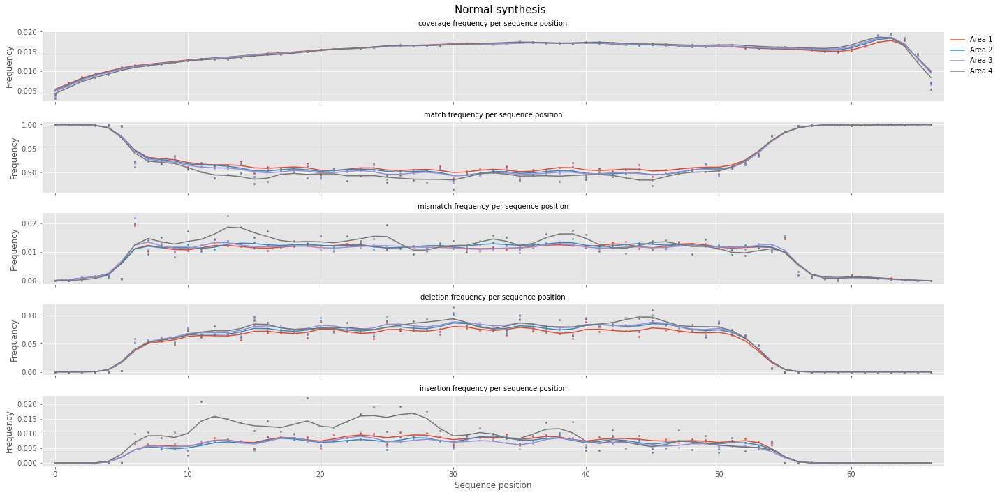

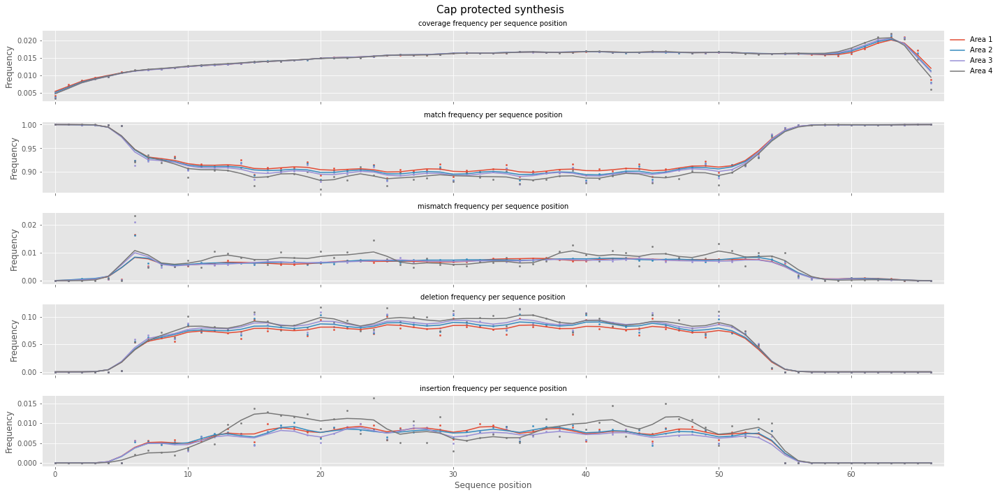

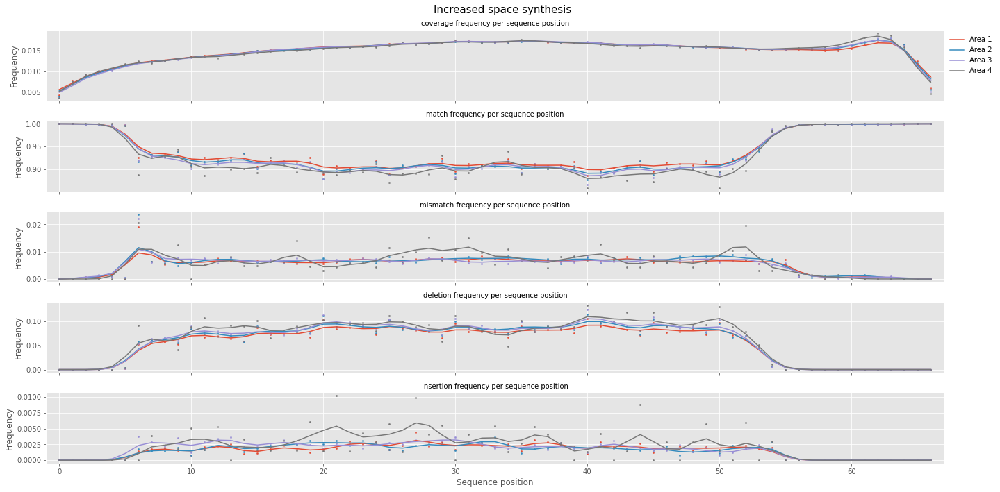

In [200]:
outdir = "position_err_freq_res"
shutil.rmtree(outdir,ignore_errors=True)
mkdir(outdir)

fasta_fn="./references/ref.fa"

for label, res_d in zip(["Normal synthesis", "Cap protected synthesis", "Increased space synthesis"], [norm_res_d, cap_res_d, space_res_d]):
    fig = plot_res_area(res_d, title=label)
    fig.savefig(f"{outdir}/{label}.svg")
    fig.savefig(f"{outdir}/{label}.png")